In [118]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from mpl_toolkits.axes_grid1 import make_axes_locatable


from ipywidgets import interact, fixed
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from matplotlib.patches import Ellipse
from scipy import linalg

#import plotly.express as px
import urllib.request
import zipfile

import matplotlib.colors as mcolors
from matplotlib.ticker import FuncFormatter
from sklearn.decomposition import PCA, FactorAnalysis
from factor_analyzer import FactorAnalyzer, calculate_kmo, calculate_bartlett_sphericity
from sklearn.preprocessing import StandardScaler


import os
# os.environ["OMP_NUM_THREADS"] = "2" 

from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV

from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, mean_absolute_percentage_error, mean_squared_error

import ast

from pathlib import Path  


from sklearn.cluster import KMeans
import geopandas as gpd

import matplotlib.patches as mpatches
from matplotlib.lines import Line2D

import matplotlib.pyplot as plt
from adjustText import adjust_text
from matplotlib.patches import Patch

import matplotlib.colors as mcolors

from adjustText import adjust_text


import warnings
warnings.filterwarnings("ignore", message="KMeans is known to have a memory leak")


<h1 style="font-size: 32px;">Typology Map</h1>

In [119]:
data = pd.read_csv('../../results/cluster-msa.csv')
new_df = pd.read_csv('../../results/cluster-msa-emissions.csv')
cities_gdf  = gpd.read_file('../../data/raw/USA_Major_Cities/USA_Major_Cities.shp')

In [120]:
data['carbon dioxide equivalent (Ton) per capita']=new_df['Emissions per capita']

In [121]:
data

,MSA,carbon dioxide equivalent (Ton),Auto + Scale,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,carbon dioxide equivalent (Ton) per capita
0,"Abilene, TX",1.604661e+06,-0.020769,-0.116631,-0.567720,-0.215719,1.024831,-0.196886,1.138187,1.305839,3,9.364594
1,"Akron, OH",4.038062e+06,-0.595251,-0.032704,2.367134,0.181770,-0.714500,-0.538529,0.487787,-0.200201,7,5.741707
2,"Albany, GA",1.062811e+06,-0.280811,0.056536,-0.590122,-0.044732,1.345877,-0.471593,0.828885,1.103606,3,7.208870
3,"Albany-Lebanon, OR",9.640033e+05,-0.234983,0.067162,-1.131492,0.029690,-0.738241,-0.138377,-0.912521,0.868893,1,7.577689
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.253770,-0.144994,0.279123,-0.278315,-1.043975,0.433586,0.400056,-0.411223,3,5.014498
...,...,...,...,...,...,...,...,...,...,...,...,...
344,"Yakima, WA",1.345779e+06,0.055568,-0.016343,-1.304796,-0.044245,-1.032406,-0.639057,0.115356,0.847270,3,5.369176
345,"York-Hanover, PA",2.087107e+06,-0.564581,0.064776,1.461622,0.149391,-0.349227,-0.563617,0.637335,0.441696,5,4.662592
346,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.082061,-0.059134,0.624753,-0.157510,-0.896252,-0.966299,0.642194,-0.369812,3,5.741362
347,"Yuba City, CA",5.800871e+05,-0.398228,0.078186,-0.467446,-0.017681,0.861001,-0.215744,-0.064006,0.458856,5,3.336922


In [122]:
divid_df=data.copy(deep=True)

# Extract city and state from MSA in df1
divid_df[['Area', 'State']] = divid_df['MSA'].str.split(', ', expand=True)
divid_df['Area'] = divid_df['Area'].str.split('-').str[0]

In [123]:
# Replace 'your_shapefile_path' with the path to your shapefile
gdf = gpd.read_file('../../data/raw/cb_2018_us_cbsa_500k/cb_2018_us_cbsa_500k.shp')
us_state = gpd.read_file('../../data/raw/cb_2018_us_state_500k/cb_2018_us_state_500k.shp')
# Filter for Metropolitan Statistical Areas (MSA)
msa_gdf = gdf[(gdf['CBSAFP'].notnull()) & (gdf['LSAD'] == 'M1')]

# Extract city and state from NAME in df2
msa_gdf[['Area', 'State']] = msa_gdf['NAME'].str.split(', ', expand=True)
msa_gdf['Area'] = msa_gdf['Area'].str.split('-').str[0]
msa_gdf

C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,State
0,None,31340,310M400US31340,31340,"Lynchburg, VA",M1,5491925729,68559452,"POLYGON ((-79.85840 37.26715, -79.85660 37.268...",Lynchburg,VA
1,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,CA
3,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,OK
5,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,CA
8,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,AR
...,...,...,...,...,...,...,...,...,...,...,...
934,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,CA
936,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,AZ
938,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,AL
939,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,CT


In [124]:
if isinstance(divid_df.columns, pd.MultiIndex):
    divid_df.columns = divid_df.columns.get_level_values(0)
if isinstance(msa_gdf.columns, pd.MultiIndex):
    msa_gdf.columns = msa_gdf.columns.get_level_values(0)

# Merge the dataframes on the 'Area' and 'State' columns
merged_df = msa_gdf.merge(divid_df, on=['Area', 'State'], suffixes=('_pivot', '_msa'))

merged_df['Emissions per capita']=new_df['Emissions per capita (MTCO2e)']
merged_df['greenhouse gas emissions (MMTCO2e)']=merged_df['carbon dioxide equivalent (Ton)']/1102311.31 #unit conversion
merged_df['Emissions per capita (MTCO2e)']=merged_df['carbon dioxide equivalent (Ton) per capita']*0.91

merged_df

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,...,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,carbon dioxide equivalent (Ton) per capita,Emissions per capita,greenhouse gas emissions (MMTCO2e),Emissions per capita (MTCO2e)
0,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,...,0.126456,0.180328,1.053644,-1.263948,-0.974766,1,4.287881,8.521780,1.932506,3.901972
1,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,...,-0.487884,0.090524,-1.106866,-0.060996,-0.654927,4,6.966569,5.224953,6.295576,6.339578
2,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,...,2.245876,0.773619,1.325500,-0.763421,-0.782388,4,5.034907,6.560072,15.182534,4.581765
3,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,...,-0.101650,0.645319,-1.359687,-0.540911,0.899830,3,8.709058,6.895697,0.706830,7.925243
4,None,17020,310M400US17020,17020,"Chico, CA",M1,4238438186,105311003,"POLYGON ((-122.06874 39.84222, -122.06694 39.8...",Chico,...,-0.048869,0.740048,0.717149,-1.326627,0.370626,3,5.296343,4.563193,1.073115,4.819672
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
341,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,...,-0.052392,0.567674,1.522081,-0.792488,-0.184363,1,4.446023,4.611721,1.139494,4.045881
342,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,...,-0.153616,2.392211,0.294441,1.447098,0.081042,3,6.081056,5.512735,1.169147,5.533761
343,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,...,-0.127031,1.246348,-1.290599,0.473791,0.624579,3,7.553308,4.528186,1.019785,6.873510
344,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,...,-0.003983,-0.379583,1.974780,-0.342436,1.537504,7,4.540907,4.885950,3.890013,4.132225


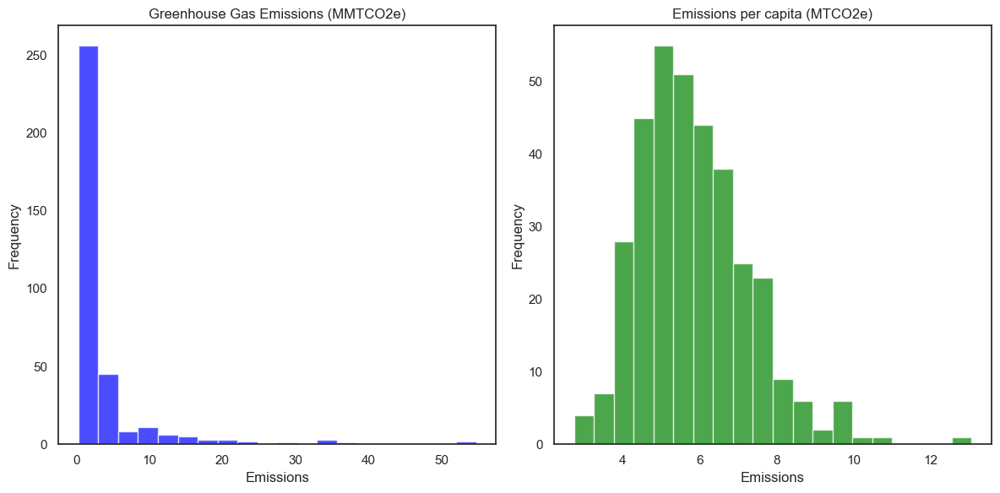

In [125]:
# Create a figure with two subplots side by side
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Plot histogram for 'greenhouse gas emissions (MMTCO2e)'
axes[0].hist(merged_df['greenhouse gas emissions (MMTCO2e)'], bins=20, alpha=0.7, color='blue')
axes[0].set_title('Greenhouse Gas Emissions (MMTCO2e)')
axes[0].set_xlabel('Emissions')
axes[0].set_ylabel('Frequency')

# Plot histogram for 'Emissions per capita'
axes[1].hist(merged_df['Emissions per capita (MTCO2e)'], bins=20, alpha=0.7, color='green')
axes[1].set_title('Emissions per capita (MTCO2e)')
axes[1].set_xlabel('Emissions')
axes[1].set_ylabel('Frequency')

# Display the plots
plt.tight_layout()  # Adjust layout to avoid overlap
plt.show()

In [126]:
#find the highest emissions

df_sorted = merged_df.sort_values('Emissions per capita (MTCO2e)', ascending=False)

# Get the first two largest emissions per capita rows
top_two_rows = df_sorted.head(10)
top_two_rows

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,...,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,carbon dioxide equivalent (Ton) per capita,Emissions per capita,greenhouse gas emissions (MMTCO2e),Emissions per capita (MTCO2e)
38,None,22380,310M400US22380,22380,"Flagstaff, AZ",M1,48222143094,110123852,"POLYGON ((-113.35413 36.04209, -113.35204 36.0...",Flagstaff,...,-0.270180,0.304770,1.739975,-1.175785,5.859772,1,14.347887,4.016310,1.851604,13.056577
268,None,24260,310M400US24260,24260,"Grand Island, NE",M1,5551584109,66761666,"POLYGON ((-98.74917 41.10522, -98.74778 41.113...",Grand Island,...,-0.067128,-0.545628,-1.017299,2.476849,1.589557,3,11.747953,6.895664,0.805627,10.690637
267,None,16940,310M400US16940,16940,"Cheyenne, WY",M1,6956354965,4348083,"POLYGON ((-105.28020 41.39538, -105.27760 41.3...",Cheyenne,...,-0.018549,-1.025744,-0.191482,1.199000,0.425520,1,11.447194,4.662237,1.030912,10.416946
178,None,15260,310M400US15260,15260,"Brunswick, GA",M1,3351230924,809179139,"MULTIPOLYGON (((-81.27939 31.30792, -81.27716 ...",Brunswick,...,-0.091521,1.515685,-0.428719,-0.520009,0.354829,3,10.917763,4.859688,1.170198,9.935165
203,544,47020,310M400US47020,47020,"Victoria, TX",M1,4491343521,36475959,"POLYGON ((-97.77853 28.66803, -97.65378 28.756...",Victoria,...,-0.070699,2.178145,0.121589,0.372020,1.166090,3,10.868331,6.835252,0.982231,9.890181
19,None,24220,310M400US24220,24220,"Grand Forks, ND-MN",M1,8824486378,78063939,"POLYGON ((-97.90342 48.08658, -97.90345 48.093...",Grand Forks,...,-0.173279,-1.541129,-0.108561,2.401037,4.536244,1,10.860960,4.331190,1.001320,9.883473
147,108,11100,310M400US11100,11100,"Amarillo, TX",M1,13338911474,87011698,"POLYGON ((-103.04278 35.24124, -103.04237 35.2...",Amarillo,...,-0.240680,0.305786,-0.682386,1.510117,0.325766,3,10.728117,6.692008,2.572707,9.762586
57,380,19300,310M400US19300,19300,"Daphne-Fairhope-Foley, AL",M1,4117546676,1133055836,"POLYGON ((-88.02858 30.22676, -88.02399 30.230...",Daphne,...,-0.120026,1.415698,-0.183012,-0.932902,-0.686359,3,10.609136,5.236051,2.100911,9.654314
245,None,45500,310M400US45500,45500,"Texarkana, TX-AR",M1,5291283400,213430554,"POLYGON ((-94.74663 33.44192, -94.74675 33.456...",Texarkana,...,-0.115705,0.760471,-1.405229,-0.281205,0.640966,3,10.562641,5.035403,1.432376,9.612003
22,356,31420,310M400US31420,31420,"Macon-Bibb County, GA",M1,4464107127,36466188,"POLYGON ((-84.20263 32.69002, -84.19676 32.701...",Macon,...,-0.091613,1.014878,-0.685263,-0.432682,0.354213,3,10.341251,5.787938,2.153647,9.410539


In [127]:
cluster_mapping = {
    4: 'Auto Large',
    5: 'Auto Small',
    7: 'Dense Active',
    6: 'Heavyweight Eco-Transit',
    2: 'Heavyweight Transit',
    1: 'Sparse Active',
    3: 'Sparse Auto'
}


cluster_labels = cluster_mapping 

# Order of cluster numbers in cluster_mapping
cluster_order = [4, 5, 7, 6, 2, 1, 3]

# Custom palette
custom_palette = ['#FDBF6F', '#FF7F00', '#1F78B4', '#B2DF8A', '#33A02C', '#FB9A99', '#E31A1C']

# Map the custom palette to the cluster order
ordered_palette = [custom_palette[cluster_order.index(cluster)] for cluster in sorted(cluster_mapping.keys())]

ordered_palette

['#FB9A99', '#33A02C', '#E31A1C', '#FDBF6F', '#FF7F00', '#B2DF8A', '#1F78B4']

In [128]:
# Sort the DataFrame by 'Emissions per capita (MTCO2e)' in descending order
top_10_emissions = merged_df.sort_values('Emissions per capita (MTCO2e)', ascending=False).head(10)

# Display the top 10 rows with the highest emissions per capita
print(top_10_emissions[['MSA', 'Emissions per capita (MTCO2e)']])


                           MSA  Emissions per capita (MTCO2e)
38               Flagstaff, AZ                      13.056577
268           Grand Island, NE                      10.690637
267               Cheyenne, WY                      10.416946
178              Brunswick, GA                       9.935165
203               Victoria, TX                       9.890181
19          Grand Forks, ND-MN                       9.883473
147               Amarillo, TX                       9.762586
57   Daphne-Fairhope-Foley, AL                       9.654314
245           Texarkana, TX-AR                       9.612003
22       Macon-Bibb County, GA                       9.410539


In [129]:
major_cities = [
    ('Chicago', 'IL'), ('New York', 'NY'), ('Los Angeles', 'CA'), ('Houston', 'TX'), ('Michigan', 'MI'), 
    ('Minneapolis', 'MN'), ('Atlanta', 'GA'), ('San Francisco', 'CA'), ('Dallas', 'TX'), ('St. Louis', 'MO'),
    ('Phoenix', 'AZ'), ('Miami', 'FL'),('Las Vegas','NV'),('Portland','OR'),('Seattle','WA'),('Boston','MA'),('San Diego', 'CA'), ('Baltimore', 'MD'), ('Cleveland', 'OH'), ('Orlando', 'FL'),
    ('Charlotte', 'NC'), ('Indianapolis', 'IN'), ('Nashville', 'TN'), ('Kansas City', 'MO'), ('Columbus', 'OH'),
    ('Austin', 'TX'), ('Omaha', 'NE'), ('Memphis', 'TN'), ('Louisville', 'KY'), ('Chicago', 'IL'), ('St. Louis', 'MO'), ('Kansas City', 'MO'), ('Oklahoma City', 'OK'),
    ('Indianapolis', 'IN'), ('Columbus', 'OH'), ('Cleveland', 'OH'), ('Minneapolis', 'MN'),
    ('Dallas', 'TX'), ('Houston', 'TX'), ('Austin', 'TX'), ('San Antonio', 'TX'), ('Memphis', 'TN'),('Billings', 'MT'), ('Missoula', 'MT'),
    ('Cheyenne', 'WY'), ('Casper', 'WY'),
    ('Boise', 'ID'), ('Idaho Falls', 'ID'),
    # ('Denver', 'CO'), 
    ('Colorado Springs', 'CO'), 
    #('Salt Lake City', 'UT'), 
    ('Albuquerque', 'NM'), 
    ('Phoenix', 'AZ'), ('Tucson', 'AZ'),
    ('Fargo', 'ND'), ('Bismarck', 'ND'),
    ('Sioux Falls', 'SD'), ('Rapid City', 'SD'),
    ('Omaha', 'NE'), 
    ('Wichita', 'KS'), 
    ('Oklahoma City', 'OK'), ('Tulsa', 'OK'),('Reno', 'NV'),
    ('Burlington', 'VT'),
    ('Portland', 'ME'),
    ('Flagstaff', 'AZ'),('Grand Island', 'NE'), ('Cheyenne', 'WY'), ('Brunswick', 'GA'), ('Victoria', 'TX'), ('Grand Forks', 'ND-MN'),('Amarillo', 'TX'),('Daphne-Fairhope-Foley', 'AL'),('Texarkana', 'TX-AR'),('Macon-Bibb County', 'GA'),
    ('Fresno', 'CA'),('Grand Island', 'NE'),('Grand Canyon', 'AZ'),('Boise City', 'ID'),('El Paso', 'TX'),('Tampa', 'FL'),('Pensacola', 'FL'),('Montgomery', 'AL'),('Spokane', 'WA'),('Yakima', 'WA'),('Salem', 'OR'),('Rochester', 'NY'),('Watertown', 'NY'),('Charleston', 'WV'),('Raleigh', 'NC'),
    ('Sacramento', 'CA'),('Chico', 'CA'),('Abilene', 'TX'),('San Angelo', 'TX'),('Lubbock', 'TX'),('Des Moines', 'IA'),('Detroit', 'MI'),('International Falls', 'MN'),('Duluth', 'MN'),
    ('San Bernardino','CA'), ('Redding','CA'),('Charleston','SC'),('Savannah','GA'),('Jackson','MS'),('Little Rock','AR'),('Grand Junction','CO'),('Bangor','ME'),('Philadelphia','PA'),
    ('Pittsburgh','PA'),('Harrisburg','PA'),('Farmington','NM'),
    ('Bellingham','WA'),('Ogden','UT'),('Provo','UT'),('Yuba City','CA'),('Ukiah','CA'),('Medford','OR'),('Springfield','MO'),('Jefferson City','MO'),
    ('Iowa City','IA'),('Grand Rapids','MI'),('Albany','NY'),('Bakersfield','CA'),
    ('Salinas','CA'),('Laredo','TX'),('Grand Forks','ND'),('Madison','WI'), ('Kingman','AZ'),('Douglas','AZ'),
    ('Great Falls','MT'),('Eugene','OR'),('Bend','OR'),('Gadsden', 'AL'),('New Haven','CT'),('Cape Coral','FL'),('Jacksonville','NC'),('Jacksonville','NC'),('New Bern', 'NC'),('Fort Wayne','IN'),('Fort Wayne','IN'),('Saginaw', 'MI'),('Racine', 'WI'),('Niles', 'MI'),('Brownsville','TX'),('Olympia', 'WA'),('Lancaster', 'PA')
    # ('Wenatchee','WA')
]

city_name_map = {
    "Los Angeles": "LA",
    # "San Francisco": "SF",
    # # "New York": "NYC",
    # "Fort Worth": "FW",
    # "Colorado Springs": "CS",
    # "Grand Forks": "GF",
    # "Des Moines": "DM",
    # "Macon-Bibb County": "Macon",
    "San Bernardino": "SB"
    # "Iowa City": "IC",
    # # "Kansas City": "KC",
    # "Iowa City": "IC",
    #  "Grand Island": "GI",
    # "Grand Rapids": "GR"
}

# Filter the major cities including the specific Dallas, TX
cities_gdf_filtered = cities_gdf[cities_gdf.apply(lambda row: (row['NAME'], row['ST']) in major_cities, axis=1)]

# Filter out only the Dallas in Texas
dallas_tx = cities_gdf[(cities_gdf['NAME'] == 'Dallas') & (cities_gdf['ST'] == 'TX')]

# Combine the filtered Dallas entry with the other cities
cities_gdf_filtered = pd.concat([cities_gdf_filtered, dallas_tx]).drop_duplicates()

# Ensure CRS matches
cities_gdf_filtered = cities_gdf_filtered.to_crs(epsg=4326)



# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(60, 60), dpi=600)

# Load shapefiles (uncomment and update paths if necessary)
# us_state = gpd.read_file('path_to_us_state_shapefile.shp')
# merged_df = gpd.read_file('path_to_merged_shapefile.shp')
# cities_gdf_filtered = gpd.read_file('path_to_cities_shapefile.shp')  # Load major cities data

# Define the custom color palette
# custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter_cmap = ListedColormap(ordered_palette)

# Plot the base map
us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the merged DataFrame with the 'Cluster' column
merged_df.plot(ax=ax, alpha=0.8, column='Cluster', cmap=color_iter_cmap, legend=False, edgecolor='black', linewidth=0.5)

    

cities_gdf_filtered.plot(ax=ax, color='black', markersize=100)

# Annotate the cities and store text objects for adjustment
texts = []
for idx, row in cities_gdf_filtered.iterrows():
    city_name = row['NAME']
    
    # Shorten the city name if it exists in the city_name_map
    city_name = city_name_map.get(city_name, city_name)
    
    text = ax.annotate(city_name, 
                       xy=(row.geometry.x, row.geometry.y), 
                       xytext=(0, -30),  # Offset label below the marker
                       textcoords='offset points', 
                       fontsize=35, 
                       color='black', 
                       ha='center')  # Horizontal alignment to center the text
    texts.append(text)


adjust_text(texts, 
            ax=ax, 
            expand_text=(0.2, 0.2),  # Expands in x and y direction
            expand_points=(0.1, 0.1), # Expands around points
            force_text=(1, 1),  # Pushes text apart
            arrowprops=dict(arrowstyle="-", color='gray', lw=0.5))  # Optional arrows to original positions

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(25, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# # Ensure the order of legend corresponds to the cluster numbers
# legend_elements = [
#     Patch(facecolor=color_iter_cmap(i), edgecolor='black', label=cluster_labels[i + 1]) 
#     for i in range(len(cluster_labels))
# ]

# # Create the legend and manually divide into two rows
# leg = ax.legend(
#     handles=legend_elements, 
#     loc='upper center', 
#     bbox_to_anchor=(0.5, -0.05), 
#     ncol=4,  # Specify 4 columns
#     frameon=False, 
#     fontsize=45, 
#     title_fontsize='45',
#     title='Type',
#     columnspacing=0.8,  # Adjust spacing between columns
#     handletextpad=0.5,  # Adjust spacing between the legend icon and text
#     handlelength=2.0,  # Adjust length of legend handles
#     labelspacing=0.8  # Adjust spacing between labels
# )

# Define the manual color mapping
cluster_mapping = {
    4: 'Auto Large',
    5: 'Auto Small',
    7: 'Dense Active',
    6: 'Heavyweight Eco-Transit',
    2: 'Heavyweight Transit',
    1: 'Sparse Active',
    3: 'Sparse Auto'
}

# Define the corresponding colors for the clusters
color_mapping = {
    'Auto Large': '#FDBF6F',
    'Auto Small': '#FF7F00',
    'Dense Active': '#1F78B4',
    'Heavyweight Eco-Transit': '#B2DF8A',
    'Heavyweight Transit': '#33A02C',
    'Sparse Active': '#FB9A99',
    'Sparse Auto': '#E31A1C'
}

# Create legend elements in the specified order
legend_elements = [
    Patch(
        facecolor=color_mapping[cluster_mapping[cluster]], 
        edgecolor='black', 
        label=cluster_mapping[cluster]
    ) 
    for cluster in [4, 5, 7, 6, 2, 1, 3]
]

# Add the legend on the right side
leg = ax.legend(
    handles=legend_elements, 
    loc='center left', 
    bbox_to_anchor=(0.8, 0.3),  # Legend on the right, vertically centered
    frameon=False, 
    fontsize=40,  # Increased fontsize for better visibility
    title='Type', 
    title_fontsize='40',
    labelspacing=1  # Adjust spacing between legend items
)

# Adjust layout to avoid cutting off the legend
plt.tight_layout()

# Save the figure with bbox_extra_artists to include the legend
plt.savefig(
    '../../figures/typemap.jpg', 
    dpi=600, 
    bbox_inches='tight', 
    bbox_extra_artists=[leg],  # Include the legend in the bounding box
    pad_inches=0.2  # Slight padding for a clean margin
)


<h1 style="font-size: 32px;">Emissions vs Per-capita Emissions</h1>

In [130]:
# save the typology map data
columns_to_drop = ['carbon dioxide equivalent (Ton)', 'Auto + Scale', 'Transit Propensity',
       'Density', 'Sustainable Transit', 'Warm Weather', 'Remote + Active',
       'Network Connectivity', 'Network Sprawl','carbon dioxide equivalent (Ton) per capita',
       'greenhouse gas emissions (MMTCO2e)']

# Drop the columns
df_cleaned = merged_df.drop(columns=columns_to_drop)

df_cleaned['Cluster Name'] = df_cleaned['Cluster'].map(cluster_mapping)
df_cleaned['central city'] = df_cleaned['MSA'].str.split('-|,').str[0]
df_cleaned
df_cleaned.to_csv('../../data/tidy/emissions_typology_map.csv', index=False)

us_state.to_csv('../../data/tidy/us_state.csv', index=False)

# Cluster mapping
cluster_mapping = {
    4: 'Auto Large',
    5: 'Auto Small',
    7: 'Dense Active',
    6: 'Heavyweight Eco-Transit',
    2: 'Heavyweight Transit',
    1: 'Sparse Active',
    3: 'Sparse Auto'
}

# Map the cluster column to the cluster names
new_df['Cluster Name'] = new_df['Cluster'].map(cluster_mapping)
new_df.to_csv('../../data/tidy/emisisons_msa.csv', index=False)
new_df

,MSA,carbon dioxide equivalent (Ton),Auto + Scale,Transit Propensity,Density,Sustainable Transit,Warm Weather,Remote + Active,Network Connectivity,Network Sprawl,Cluster,Population,Emissions per capita,carbon dioxide equivalent (MMTCO2e),Emissions per capita (MTCO2e),Cluster Name
0,"Abilene, TX",1.604661e+06,-0.020769,-0.116631,-0.567720,-0.215719,1.024831,-0.196886,1.138187,1.305839,NaN,171354,9.364594,1.455724,8.521780,NaN
1,"Akron, OH",4.038062e+06,-0.595251,-0.032704,2.367134,0.181770,-0.714500,-0.538529,0.487787,-0.200201,NaN,703286,5.741707,3.663268,5.224953,NaN
2,"Albany, GA",1.062811e+06,-0.280811,0.056536,-0.590122,-0.044732,1.345877,-0.471593,0.828885,1.103606,NaN,147431,7.208870,0.964166,6.560072,NaN
3,"Albany-Lebanon, OR",9.640033e+05,-0.234983,0.067162,-1.131492,0.029690,-0.738241,-0.138377,-0.912521,0.868893,NaN,127216,7.577689,0.874529,6.895697,NaN
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.253770,-0.144994,0.279123,-0.278315,-1.043975,0.433586,0.400056,-0.411223,NaN,880766,5.014498,4.006672,4.563193,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344,"Yakima, WA",1.345779e+06,0.055568,-0.016343,-1.304796,-0.044245,-1.032406,-0.639057,0.115356,0.847270,NaN,250649,5.369176,1.220870,4.885950,NaN
345,"York-Hanover, PA",2.087107e+06,-0.564581,0.064776,1.461622,0.149391,-0.349227,-0.563617,0.637335,0.441696,NaN,447628,4.662592,1.893391,4.242959,NaN
346,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.082061,-0.059134,0.624753,-0.157510,-0.896252,-0.966299,0.642194,-0.369812,NaN,538115,5.741362,2.802759,5.224640,NaN
347,"Yuba City, CA",5.800871e+05,-0.398228,0.078186,-0.467446,-0.017681,0.861001,-0.215744,-0.064006,0.458856,NaN,173839,3.336922,0.526246,3.036599,NaN


In [131]:
label=cluster_mapping[cluster_order[2]]

In [132]:
cities_gdf

# Assuming your data is already loaded into a DataFrame called 'df'
nd_row = cities_gdf[cities_gdf['ST'] == 'ND']

nd_row

,FID,NAME,CLASS,ST,STFIPS,PLACEFIPS,CAPITAL,POP_CLASS,POPULATION,POP2010,...,MARHH_NO_C,MHH_CHILD,FHH_CHILD,FAMILIES,AVE_FAM_SZ,HSE_UNITS,VACANT,OWNER_OCC,RENTER_OCC,geometry
2338,2339,Bismarck,city,ND,38,3807200,State,7,72334,61272,...,7514,573,1828,15624,2.82,28648,1385,17122,10141,POINT (-100.76952 46.81247)
2339,2340,Dickinson,city,ND,38,3819620,None,6,25991,17787,...,2042,171,425,4308,2.89,7865,344,4625,2896,POINT (-102.78911 46.89069)
2340,2341,Fargo,city,ND,38,3825700,None,8,125362,105549,...,9786,1003,2753,23075,2.87,49956,3165,21433,25358,POINT (-96.80696 46.86757)
2341,2342,Grand Forks,city,ND,38,3832060,None,7,58526,52838,...,4913,471,1508,11275,2.87,23449,1189,10519,11741,POINT (-97.05851 47.92279)
2342,2343,Jamestown,city,ND,38,3840580,None,6,15731,15427,...,1741,186,439,3555,2.78,6983,416,3869,2698,POINT (-98.69266 46.90653)
2343,2344,Mandan,city,ND,38,3849900,None,6,21359,18331,...,2219,245,653,4921,2.89,7950,318,5286,2346,POINT (-100.88302 46.82556)
2344,2345,Minot,city,ND,38,3853380,None,6,48923,40888,...,4548,437,1214,9978,2.86,18744,881,10837,7026,POINT (-101.30686 48.23898)
2345,2346,West Fargo,city,ND,38,3884780,None,6,33649,25830,...,2741,270,697,6823,3.04,10760,412,6886,3462,POINT (-96.90448 46.85727)
2346,2347,Williston,city,ND,38,3886220,None,6,29984,14716,...,1565,177,392,3589,2.99,6542,362,3855,2325,POINT (-103.62803 48.15423)


In [133]:
# Filter the DataFrame for Cluster 1
cluster_1_names = merged_df[merged_df['Cluster'] == 2]['NAME']

cluster_1_names

170    New York-Newark-Jersey City, NY-NJ-PA
Name: NAME, dtype: object

In [134]:
# Sort the DataFrame by 'Emissions per capita (MTCO2e)' in descending order
top_10_emissions_per_capita = merged_df.sort_values(by='Emissions per capita (MTCO2e)', ascending=False).head(10)

# Extract the names of the top 10 MSAs
top_10_msa_names = top_10_emissions_per_capita['NAME'].tolist()



In [135]:
# Sort the DataFrame by 'Emissions per capita (MTCO2e)' in descending order
top_10_emissions_per_capita = merged_df.sort_values(by='greenhouse gas emissions (MMTCO2e)', ascending=False).head(10)

# Extract the names of the top 10 MSAs
top_10_msa_names = top_10_emissions_per_capita['NAME'].tolist()


top_10_msa_names

['New York-Newark-Jersey City, NY-NJ-PA',
 'Los Angeles-Long Beach-Anaheim, CA',
 'Chicago-Naperville-Elgin, IL-IN-WI',
 'Dallas-Fort Worth-Arlington, TX',
 'Atlanta-Sandy Springs-Roswell, GA',
 'Houston-The Woodlands-Sugar Land, TX',
 'Miami-Fort Lauderdale-West Palm Beach, FL',
 'Phoenix-Mesa-Scottsdale, AZ',
 'Riverside-San Bernardino-Ontario, CA',
 'St. Louis, MO-IL']

In [136]:
# Columns you want to extract
columns_to_extract = ['MSA', 'greenhouse gas emissions (MMTCO2e)', 'Emissions per capita (MTCO2e)','Cluster']  # Replace with actual column names

# Create a new DataFrame from merged_df
new_df = merged_df[columns_to_extract]

# Create a new column 'central city' by extracting the first city from 'MSA'
new_df['central city'] = new_df['MSA'].str.split('-|,').str[0]

# Display the updated DataFrame
#new_df.to_csv('../../data/tidy/emisisons_msa.csv', index=False)
new_df

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_33432\575866332.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df['central city'] = new_df['MSA'].str.split('-|,').str[0]


,MSA,greenhouse gas emissions (MMTCO2e),Emissions per capita (MTCO2e),Cluster,central city
0,"Santa Rosa-Petaluma, CA",1.932506,3.901972,1,Santa Rosa
1,"Tulsa, OK",6.295576,6.339578,4,Tulsa
2,"San Diego-Chula Vista-Carlsbad, CA",15.182534,4.581765,4,San Diego
3,"Pine Bluff, AR",0.706830,7.925243,3,Pine Bluff
4,"Chico, CA",1.073115,4.819672,3,Chico
...,...,...,...,...,...
341,"San Luis Obispo-Paso Robles, CA",1.139494,4.045881,1,San Luis Obispo
342,"Yuma, AZ",1.169147,5.533761,3,Yuma
343,"Dothan, AL",1.019785,6.873510,3,Dothan
344,"Bridgeport-Stamford-Norwalk, CT",3.890013,4.132225,7,Bridgeport


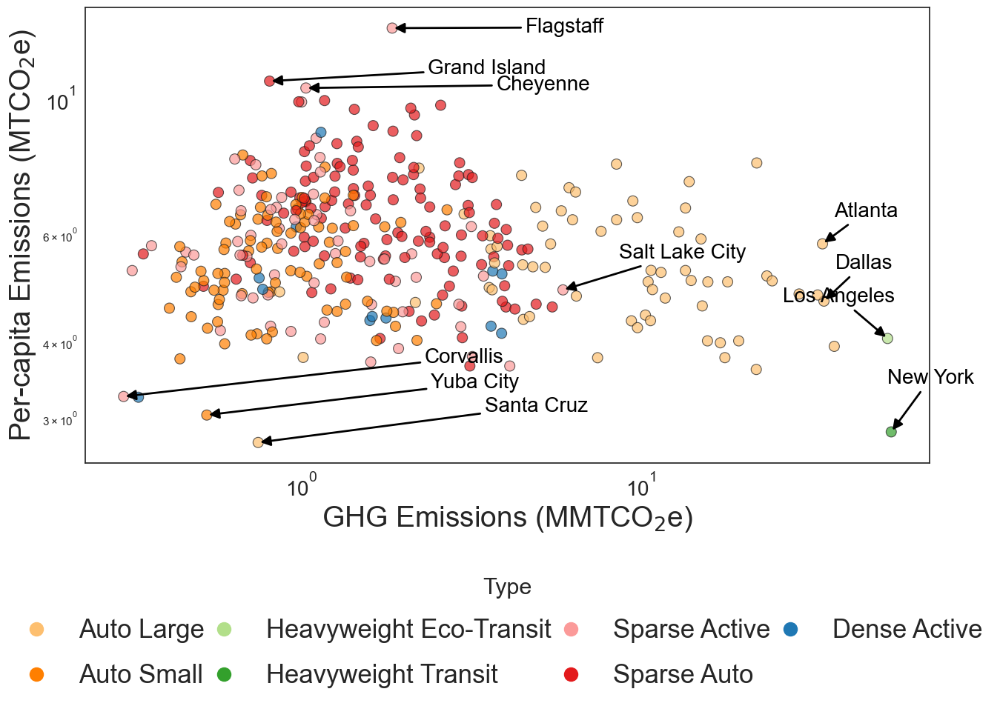

In [137]:


# Define the manual cluster mapping
cluster_mapping = {
    1: 'Sparse Active',
    2: 'Heavyweight Transit',
    3: 'Sparse Auto',
    4: 'Auto Large',
    5: 'Auto Small',
    6: 'Heavyweight Eco-Transit',
    7: 'Dense Active'
}

# Define the corresponding colors for the clusters
color_mapping = {
    'Auto Large': '#FDBF6F',
    'Auto Small': '#FF7F00',
    'Heavyweight Eco-Transit': '#B2DF8A',
    'Heavyweight Transit': '#33A02C',
    'Sparse Active': '#FB9A99',
    'Sparse Auto': '#E31A1C',
    'Dense Active': '#1F78B4'
}

# Custom legend order: alphabetical with "Dense Active" at the end
custom_legend_order = sorted([key for key in color_mapping.keys() if key != 'Dense Active']) + ['Dense Active']

# Create a scatter plot
plt.figure(figsize=(14, 10))
scatter = sns.scatterplot(
    data=merged_df,
    x='greenhouse gas emissions (MMTCO2e)',
    y='Emissions per capita (MTCO2e)',
    hue=merged_df['Cluster'].map(cluster_mapping),
    palette=color_mapping,
    s=100,
    edgecolor='k',
    alpha=0.7
)

# Prepare a list to store text annotations
texts = []

# Calculate a consistent offset for all labels
x_range = merged_df['greenhouse gas emissions (MMTCO2e)'].max() - merged_df['greenhouse gas emissions (MMTCO2e)'].min()
y_range = merged_df['Emissions per capita (MTCO2e)'].max() - merged_df['Emissions per capita (MTCO2e)'].min()
offset_x = x_range * 0.05
offset_y = y_range * 0.05

# Labeling specific MSAs with shortened names
for i in range(len(merged_df)):
    city_name = merged_df.iloc[i]['NAME']
    
    if city_name in msas_mapping:
        short_name = msas_mapping[city_name]
        x_point = merged_df.iloc[i]['greenhouse gas emissions (MMTCO2e)']
        y_point = merged_df.iloc[i]['Emissions per capita (MTCO2e)']
        
        texts.append(plt.annotate(
            short_name,
            xy=(x_point, y_point),
            xytext=(x_point + offset_x, y_point + offset_y),
            fontsize=20, color='black', ha='center', va='top',
            arrowprops=dict(arrowstyle="-|>", color='black', lw=2, mutation_scale=20)
        ))

# Use adjustText to prevent text overlaps
adjust_text(
    texts,
    expand_points=(0.5, 0.1),
    expand_text=(0.1, 0.1),
    force_text=(0.2, 0.2),
    force_points=(0.2, 0.2),
    lim=500,
    ax=plt.gca(),
    precision=0.01
)

# Create a custom legend with "Dense Active" at the end
custom_handles = [plt.Line2D([], [], marker='o', color=color_mapping[cluster], linestyle='None', markersize=10)
                 for cluster in custom_legend_order]

plt.legend(
    handles=custom_handles,
    labels=custom_legend_order,
    title='Type',
    bbox_to_anchor=(0.5, -0.2),
    loc='upper center',
    fontsize=25,
    title_fontsize=22,
    ncol=4,
    frameon=False,
    labelspacing=0.8,
    handlelength=0.3,
    handletextpad=1.5,
    columnspacing=0.6,
    markerscale=1.3
)

# Adjust the size of the x and y ticks labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Adding labels and title
plt.xlabel('GHG Emissions (MMTCO$_2$e)', fontsize=28)
plt.ylabel('Per-capita Emissions (MTCO$_2$e)', fontsize=28)
plt.xscale("log")
plt.yscale("log")
plt.tight_layout()
plt.savefig('../../figures/clusterplot.jpg', dpi=1200, bbox_inches='tight', pad_inches=0)
plt.show()
